In [ ]:
  %cd /content/

/content


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/Colab\ Notebooks/MEDAI_DEC/archive.zip -d /content/

Streaming output truncated to the last 5000 lines.
  inflating: /content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7294_19890104/TCGA_DU_7294_19890104_9_mask.tif  
  inflating: /content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_1.tif  
  inflating: /content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_10.tif  
  inflating: /content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_10_mask.tif  
  inflating: /content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_11.tif  
  inflating: /content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_11_mask.tif  
  inflating: /content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_12.tif  
  inflating: /content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_12_mask.tif  
  inflating: /content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_

In [ ]:
!pip install torchview

In [ ]:
%cd /content

/content


In [ ]:
cfg_path= "/content/lgg-mri-segmentation/kaggle_3m"

import torch
import torch.nn as nn
import torchvision
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from torchsummary import summary
from torchview import draw_graph
import torch.optim.lr_scheduler as lr_scheduler

import matplotlib.pyplot as plt
from tqdm import tqdm
import glob
import numpy as np
import pandas as pd
import seaborn as sns
import albumentations as A
from albumentations.pytorch import ToTensorV2
import PIL
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_fscore_support, accuracy_score, f1_score, matthews_corrcoef


import random
from collections import defaultdict
import os
import shutil
import copy
from typing import Dict, List, Tuple
import graphviz


# /content/lgg-mri-segmentation/kaggle_3m/TCGA_CS_4941_19960909/TCGA_CS_4941_19960909_1.tif

In [ ]:
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

BATCH_SIZE = (
        20 if torch.cuda.device_count() < 2
        else (20 * torch.cuda.device_count())
    )
seed =768
NUM_WORKERS = os.cpu_count()

LR = 1e-4
PATIENCE= 5
EPOCHS=50

NUM_DEVICES = torch.cuda.device_count()



In [ ]:
NUM_DEVICES

1

In [ ]:
# Fetching files from the directory
file_list= glob.glob(cfg_path+"/*/*.tif", recursive= True)

In [ ]:
len(file_list)

7858

In [ ]:
file_list[:5]

['/content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7300_19910814/TCGA_DU_7300_19910814_6.tif',
 '/content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7300_19910814/TCGA_DU_7300_19910814_17_mask.tif',
 '/content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7300_19910814/TCGA_DU_7300_19910814_5_mask.tif',
 '/content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7300_19910814/TCGA_DU_7300_19910814_29.tif',
 '/content/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7300_19910814/TCGA_DU_7300_19910814_29_mask.tif']

In [ ]:
# ID sorting for each scan

fl_copy= file_list

In [ ]:
def get_sample_numbers(image_paths):
  sample_numbers= []
  is_mask= []
  for f in image_paths:
    path_list= f.split('/')[-2:][1].split('_')
    print(path_list)

    if 'mask.tif' in path_list:
      sample_numbers.append(int(path_list[-2]))
      is_mask.append(1)
      print(is_mask)
      print(sample_numbers)
    else:
      sample_numbers.append(int(path_list[-1].replace('.tif', '')))
      is_mask.append(0)

  return sample_numbers, is_mask

def get_sample_patient_id(image_paths):
  return [(id_.split('/')[-2:][0]) for id_ in image_paths]



In [ ]:
get_sample_numbers(file_list)

['TCGA', 'DU', '7300', '19910814', '6.tif']
['TCGA', 'DU', '7300', '19910814', '17', 'mask.tif']
[0, 1]
[6, 17]
['TCGA', 'DU', '7300', '19910814', '5', 'mask.tif']
[0, 1, 1]
[6, 17, 5]
['TCGA', 'DU', '7300', '19910814', '29.tif']
['TCGA', 'DU', '7300', '19910814', '29', 'mask.tif']
[0, 1, 1, 0, 1]
[6, 17, 5, 29, 29]
['TCGA', 'DU', '7300', '19910814', '27', 'mask.tif']
[0, 1, 1, 0, 1, 1]
[6, 17, 5, 29, 29, 27]
['TCGA', 'DU', '7300', '19910814', '25.tif']
['TCGA', 'DU', '7300', '19910814', '27.tif']
['TCGA', 'DU', '7300', '19910814', '10.tif']
['TCGA', 'DU', '7300', '19910814', '7', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1]
[6, 17, 5, 29, 29, 27, 25, 27, 10, 7]
['TCGA', 'DU', '7300', '19910814', '11', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1]
[6, 17, 5, 29, 29, 27, 25, 27, 10, 7, 11]
['TCGA', 'DU', '7300', '19910814', '21.tif']
['TCGA', 'DU', '7300', '19910814', '18', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1]
[6, 17, 5, 29, 29, 27, 25, 27, 10, 7, 11, 21, 18]
['TCGA', 'DU',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['TCGA', 'DU', '7008', '19830723', '33.tif']
['TCGA', 'DU', '7008', '19830723', '45', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



([6,
  17,
  5,
  29,
  29,
  27,
  25,
  27,
  10,
  7,
  11,
  21,
  18,
  26,
  33,
  23,
  35,
  5,
  36,
  19,
  9,
  16,
  24,
  30,
  12,
  12,
  9,
  14,
  3,
  33,
  4,
  22,
  7,
  10,
  16,
  36,
  14,
  8,
  34,
  13,
  25,
  2,
  23,
  31,
  18,
  8,
  32,
  15,
  34,
  11,
  22,
  1,
  21,
  32,
  28,
  20,
  28,
  4,
  26,
  17,
  24,
  20,
  13,
  1,
  30,
  2,
  19,
  15,
  35,
  31,
  6,
  3,
  5,
  7,
  17,
  17,
  18,
  11,
  4,
  10,
  11,
  9,
  20,
  4,
  16,
  8,
  12,
  3,
  12,
  10,
  14,
  13,
  1,
  2,
  14,
  18,
  5,
  19,
  7,
  9,
  3,
  8,
  19,
  6,
  15,
  6,
  13,
  15,
  1,
  16,
  2,
  20,
  7,
  31,
  33,
  20,
  27,
  29,
  14,
  1,
  28,
  4,
  3,
  2,
  9,
  34,
  22,
  30,
  17,
  23,
  13,
  32,
  7,
  14,
  8,
  35,
  15,
  25,
  18,
  24,
  1,
  28,
  11,
  11,
  16,
  20,
  21,
  27,
  26,
  30,
  22,
  6,
  9,
  8,
  2,
  18,
  4,
  5,
  6,
  24,
  26,
  35,
  19,
  15,
  5,
  21,
  10,
  32,
  10,
  23,
  33,
  3,
  12,
  17,
  13,
  25

In [ ]:
get_sample_patient_id(file_list)

['TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_7300_19910814',
 'TCGA_DU_73

In [ ]:
def build_df(image_paths):
  sample_numbers, mask_label= get_sample_numbers(image_paths)
  sample_df= pd.DataFrame({
      'id': sample_numbers ,
      'patient': get_sample_patient_id(image_paths),
      'image_path': image_paths,
      'is_mask': mask_label,

  })
  return sample_df

In [ ]:
dataset_df=(build_df(file_list).sort_values(by= ['id', 'patient', 'image_path']).reset_index(drop= True))

['TCGA', 'DU', '7300', '19910814', '6.tif']
['TCGA', 'DU', '7300', '19910814', '17', 'mask.tif']
[0, 1]
[6, 17]
['TCGA', 'DU', '7300', '19910814', '5', 'mask.tif']
[0, 1, 1]
[6, 17, 5]
['TCGA', 'DU', '7300', '19910814', '29.tif']
['TCGA', 'DU', '7300', '19910814', '29', 'mask.tif']
[0, 1, 1, 0, 1]
[6, 17, 5, 29, 29]
['TCGA', 'DU', '7300', '19910814', '27', 'mask.tif']
[0, 1, 1, 0, 1, 1]
[6, 17, 5, 29, 29, 27]
['TCGA', 'DU', '7300', '19910814', '25.tif']
['TCGA', 'DU', '7300', '19910814', '27.tif']
['TCGA', 'DU', '7300', '19910814', '10.tif']
['TCGA', 'DU', '7300', '19910814', '7', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1]
[6, 17, 5, 29, 29, 27, 25, 27, 10, 7]
['TCGA', 'DU', '7300', '19910814', '11', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1]
[6, 17, 5, 29, 29, 27, 25, 27, 10, 7, 11]
['TCGA', 'DU', '7300', '19910814', '21.tif']
['TCGA', 'DU', '7300', '19910814', '18', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1]
[6, 17, 5, 29, 29, 27, 25, 27, 10, 7, 11, 21, 18]
['TCGA', 'DU',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['TCGA', 'DU', '6407', '19860514', '4', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['TCGA', 'DU', '7010', '19860307', '18.tif']
['TCGA', 'DU', '7010', '19860307', '53', 'mask.tif']
[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
dataset_df.head()

,id,patient,image_path,is_mask
0,1,TCGA_CS_4941_19960909,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
1,1,TCGA_CS_4941_19960909,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,1
2,1,TCGA_CS_4942_19970222,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
3,1,TCGA_CS_4942_19970222,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,1
4,1,TCGA_CS_4943_20000902,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0


In [ ]:
#Group Samples by mask status

grouped_df= dataset_df.groupby(by= 'is_mask')

image_df, mask_df= (grouped_df.get_group(0).drop('is_mask', axis= 1).reset_index(drop=True),
                    grouped_df.get_group(1).drop('is_mask', axis= 1).reset_index(drop=True)
)



In [ ]:
mask_df= mask_df.rename({'image_path' : 'mask_path'}, axis=1)

In [ ]:
mask_df

,id,patient,mask_path
0,1,TCGA_CS_4941_19960909,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
1,1,TCGA_CS_4942_19970222,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
2,1,TCGA_CS_4943_20000902,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
3,1,TCGA_CS_4944_20010208,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
4,1,TCGA_CS_5393_19990606,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
...,...,...,...
3924,86,TCGA_HT_A61B_19991127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...
3925,87,TCGA_HT_A61A_20000127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...
3926,87,TCGA_HT_A61B_19991127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...
3927,88,TCGA_HT_A61A_20000127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...


In [ ]:
def _load(image_path, as_tensor= True):
  image=Image.open(image_path)
  image= np.array(image).astype(np.float32) / 255.
  return image

def generate_label(mask_path, load_fn):
  mask= load_fn(mask_path)
  if mask.max() > 0:
    return 1
  return 0

In [ ]:
ds= image_df.merge(mask_df, on=['id', 'patient'], how='left')



In [ ]:
ds

,id,patient,image_path,mask_path
0,1,TCGA_CS_4941_19960909,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
1,1,TCGA_CS_4942_19970222,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
2,1,TCGA_CS_4943_20000902,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
3,1,TCGA_CS_4944_20010208,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
4,1,TCGA_CS_5393_19990606,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...
...,...,...,...,...
3924,86,TCGA_HT_A61B_19991127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...
3925,87,TCGA_HT_A61A_20000127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...
3926,87,TCGA_HT_A61B_19991127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...
3927,88,TCGA_HT_A61A_20000127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...


In [ ]:
ds['diagnosis'] = [generate_label(_, _load) for _ in tqdm(ds['mask_path'])]

100%|██████████| 3929/3929 [00:07<00:00, 544.24it/s]


In [ ]:
ds

,id,patient,image_path,mask_path,diagnosis
0,1,TCGA_CS_4941_19960909,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
1,1,TCGA_CS_4942_19970222,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
2,1,TCGA_CS_4943_20000902,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
3,1,TCGA_CS_4944_20010208,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
4,1,TCGA_CS_5393_19990606,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_C...,0
...,...,...,...,...,...
3924,86,TCGA_HT_A61B_19991127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,0
3925,87,TCGA_HT_A61A_20000127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,0
3926,87,TCGA_HT_A61B_19991127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,0
3927,88,TCGA_HT_A61A_20000127,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,0


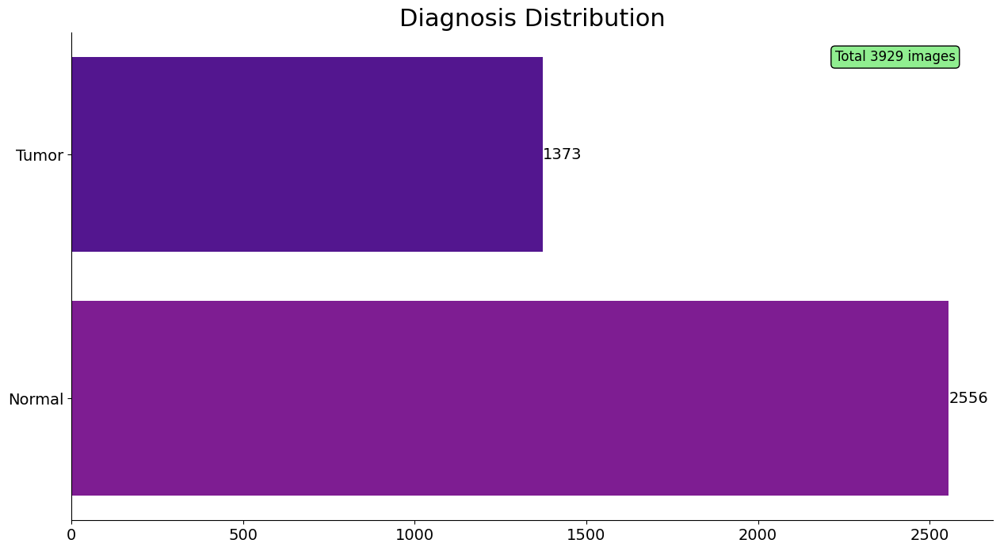

In [ ]:
# To View Diagnosis Distribution

fig= plt.figure(figsize= (15,8))

plt.title("Diagnosis Distribution", fontsize= 22)

diagnosis_distribution =ds['diagnosis'].value_counts().sort_values()
diagnosis_map = {0 : 'Normal', 1 : 'Tumor'}

bar_plot= sns.barplot(
    x= diagnosis_distribution.values,
    y= [diagnosis_map[_] for _ in diagnosis_distribution.keys()],
    palette= sns.color_palette("plasma"),
    orient= 'h'
)

for container in bar_plot.containers:
  bar_plot.bar_label(container, fmt= '%.0f', fontsize= 14)

plt.xticks(fontsize= 14)
plt.yticks(fontsize= 14)

text_params= {
    'x' : 2400,
    'y' : -0.4,
    's' : f"Total {len(ds)} images",
    'size' : 12,
    'color' : "Black",
    'ha'    : "center",
    'va'    : "center",
    'bbox'  : dict(boxstyle= "round", fc= ("lightgreen"), ec= ("black"))

}
plt.text(**text_params)

sns.despine()




diagnosi_map= [_ for _ in diagnosis_distribution.keys()]


In [ ]:
def view_sample(image, mask, color_map= 'rgb', fig_size= (16,8), title_size= 18):
  plt.figure(figsize= fig_size);
  plt.tight_layout();
  plt.subplots_adjust(top= 0.95);

  plt.subplot(1,3, 1);
  plt.title("MRI", fontsize= title_size);
  if color_map == "rgb":
    plt.imshow(image);
  else:
    plt.imshow(image, cmap= color_map);

  plt.subplot(1, 3, 2);
  plt.title("Mask", fontsize= title_size);
  plt.imshow(mask, cmap= "gray");

  plt.subplot(1, 3, 3);
  plt.title("MRI + Mask", fontsize= title_size);

  if color_map == "rgb":
    plt.imshow(image)
  else:
    plt.imshow(image, cmap= color_map)

  plt.imshow(mask, cmap="gray", alpha= 0.5);

  return








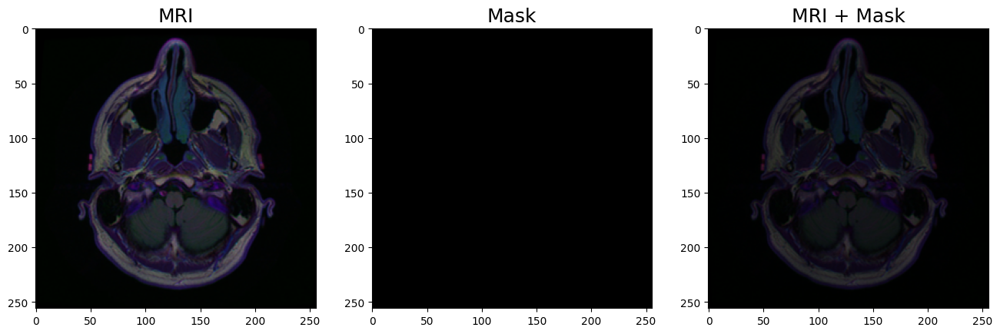

In [ ]:
rd_num= random.sample(ds.index.to_list(), 1)[0]

sample_image, sample_mask= _load(ds.image_path[rd_num]),  _load(ds.mask_path[rd_num])

view_sample(sample_image, sample_mask, color_map= 'mako')

In [ ]:
def view_multiple_sample(df, sample_loader, count= 10, color_map= "rgb", fig_size= (14, 10) ,title_size= 18):

  rd_num= random.sample(df.index.to_list(), count)

  plt.figure(figsize= fig_size);
  plt.tight_layout();
  plt.subplots_adjust(top= 0.95)

  for x, y in enumerate(rd_num):
    image, mask= (
        sample_loader(df.image_path[y]),
        sample_loader(df.mask_path[y])
  )

    idx= 3 * (x+1)

    plt.subplot(count+1, 3, idx+1);
    plt.title("MRI", fontsize= title_size);
    if color_map== "rgb":
      plt.imshow(image);
    else:
      plt.imshow(image, cmap= color_map);

    plt.subplot(count+1, 3, idx+2);
    plt.title("Mask", fontsize= title_size);
    plt.imshow(mask, cmap= "gray")

    plt.subplot(count+1, 3, idx+3)
    plt.title("MRI + MASK", fontsize= title_size)
    if color_map== "rgb":
      plt.imshow(image)
    else:
      plt.imshow(image, cmap= color_map)
    plt.imshow(mask, cmap ="gray", alpha= 0.5)

  return




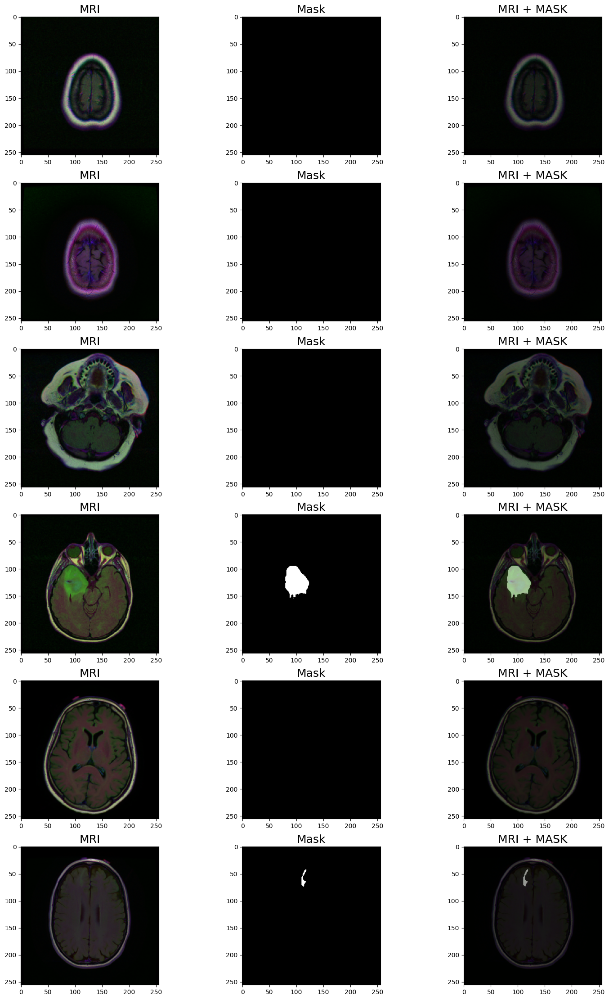

In [ ]:
view_multiple_sample(ds, _load, count=6, color_map = "mako", fig_size= (18, 30)  )


In [ ]:
# Splitting the dataset for training


train_split_idx, data_split_idx, _, _= train_test_split(ds.index, ds.diagnosis, test_size= 0.30, stratify= ds.diagnosis, random_state= seed)

In [ ]:
train_df= ds.iloc[train_split_idx].reset_index(drop=True)
data_df= ds.iloc[data_split_idx].reset_index(drop=True)

In [ ]:
print(train_df.shape)
print(data_df.shape)

(2750, 5)
(1179, 5)


In [ ]:
val_split_idx, test_split_idx, _, _ = train_test_split(data_df.index, data_df.diagnosis, test_size= 0.65, stratify = data_df.diagnosis, random_state= seed )

In [ ]:
val_df= data_df.iloc[val_split_idx].reset_index(drop= True)
test_df= data_df.iloc[test_split_idx].reset_index(drop= True)

In [ ]:
print(val_df.shape)
print(test_df.shape)

(412, 5)
(767, 5)


In [ ]:
train_size= len(train_df)
test_size= len(test_df)
val_size= len(val_df)
total_size= train_size + test_size + val_size

print("===================================================")
print(f'Training Sample Size:\t\t{train_size}\t({(100 * train_size/total_size):.2f}%)')
print(f'Testing Sample Size:\t\t{test_size}\t({(100 * test_size/total_size):.2f}%)')
print(f'Validation Sample Size:\t\t{val_size}\t({(100 * val_size/total_size):.2f}%)')
print("===================================================")

print(f'Total \t\t\t\t{total_size}\t({(100 * total_size/total_size):.2f}%)')


Training Sample Size:		2750	(69.99%)
Testing Sample Size:		767	(19.52%)
Validation Sample Size:		412	(10.49%)
Total 				3929	(100.00%)


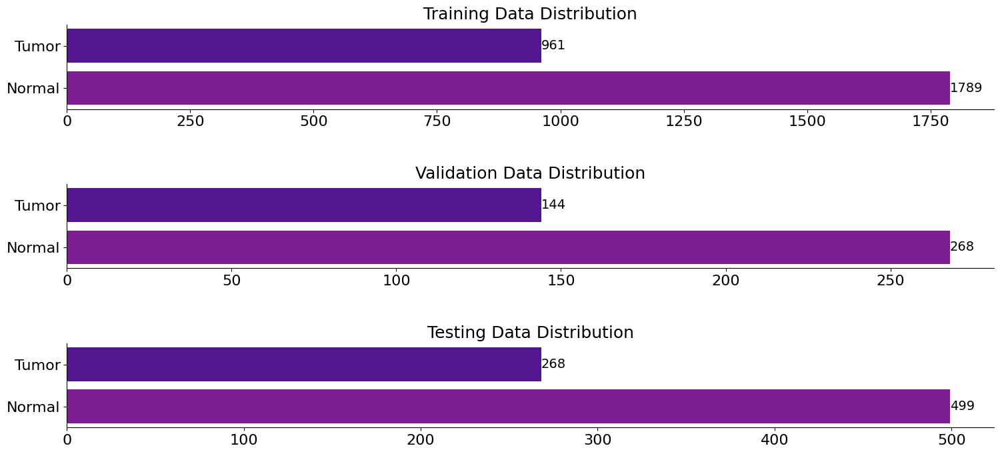

In [ ]:
fig, (ax1, ax2, ax3)= plt.subplots(3, figsize= (16, 8))
fig.tight_layout(pad= 6.0)

sns.despine()

#Train distribution
ax1.set_title("Training Data Distribution", fontsize= 18)
train_distribution= train_df['diagnosis'].value_counts().sort_values()
distribution_map = {0: 'Normal', 1 : 'Tumor'}

bar_plot= sns.barplot(
    x= train_distribution.values,
    y= [distribution_map[_] for _ in train_distribution.keys()],
    orient= 'h', palette= sns.color_palette('plasma'),
    ax= ax1

);

for container in bar_plot.containers:
  bar_plot.bar_label(container, fmt='%.0f', fontsize= 14);

# Axis tick parameters
ax1.tick_params(axis= 'both', which= 'major', labelsize= 16);

#Validation data distribution
ax2.set_title("Validation Data Distribution", fontsize= 18)
val_distribution= val_df['diagnosis'].value_counts().sort_values()

bar_plot= sns.barplot(
    x= val_distribution.values,
    y= [distribution_map[_] for _ in val_distribution.keys()],
    orient= 'h', palette= sns.color_palette('plasma'),
    ax= ax2

)
for container in bar_plot.containers:
  bar_plot.bar_label(container, fmt= '%.0f', fontsize= 14)

# Axis tick parameters
ax2.tick_params(axis= 'both', which= 'major', labelsize=16);

#Test data distribution
ax3.set_title("Testing Data Distribution", fontsize= 18)
test_distribution= test_df['diagnosis'].value_counts().sort_values()

bar_plot= sns.barplot(
    x= test_distribution.values,
    y= [distribution_map[_] for _ in test_distribution.keys()],
    orient= 'h', palette= sns.color_palette('plasma'),
    ax= ax3

)

for container in bar_plot.containers:
  bar_plot.bar_label(container, fmt= '%.0f', fontsize= 14 )

#axis Parameters
ax3.tick_params(axis= 'both', which= 'major', labelsize= 16)






In [ ]:

#Augment train data
train_transforms= A.Compose([
    A.Resize(224, 224, p=1.0),
    A.RandomBrightnessContrast(p=0.2),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    ToTensorV2(),
])

# Reshape Inference data

inference_transforms= A.Compose([
    A.Resize(224, 224, p=1.0),
    ToTensorV2(),
])


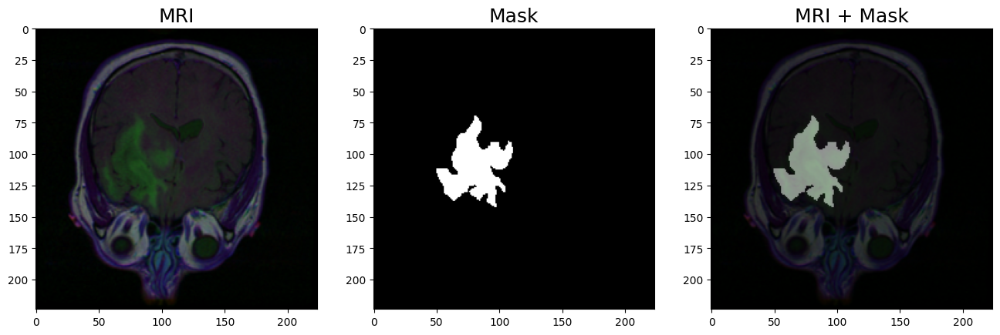

In [ ]:
# Select random sample from train_df
idx= random.sample(train_df.index.to_list(), 1)[0]

# Load the random sample and label
sample_image, sample_label= _load(train_df.image_path[idx]), _load(train_df.mask_path[idx])

aug= train_transforms(image= sample_image, mask= sample_label)

# View the random sample
view_sample(image= aug['image'].permute(1,2,0), mask= aug['mask'].unsqueeze_(0).permute(1,2,0), color_map= 'mako')


In [ ]:
class MRISegmentationDataset(Dataset):
  def __init__(self, df:pd.DataFrame, transform= None) -> None:
    super().__init__()

    self.mri_paths= df['image_path'].to_list()
    self.mask_paths= df['mask_path'].to_list()

    self.transform= transform

  def load_sample(self, index:str) -> Image.Image:
    image_path= self.mri_paths[index]
    mask_path= self.mask_paths[index]

    image= Image.open(image_path)
    mask= Image.open(mask_path)

    image= np.array(image).astype(np.float32) /255.
    mask= np.array(mask).astype(np.float32) /255.


    return image, mask

  def __len__(self) -> int:
    return self.mri_paths.__len__()

  def __getitem__(self, index:int) -> Tuple[torch.Tensor, torch.Tensor]:
    image,mask = self.load_sample(index)

    if self.transform:
      transformed= self.transform(image= image, mask= mask)
      return transformed['image'], transformed['mask'].unsqueeze_(0)
    else:
      transformed= ToTensorV2()(image= image, mask=mask)
      return transformed['image'], transformed['mask'].unsqueeze_(0)








In [ ]:
#Building Datasets
train_ds= MRISegmentationDataset(train_df, transform= train_transforms)

val_ds= MRISegmentationDataset(val_df, transform= inference_transforms)

test_ds= MRISegmentationDataset(test_df, transform= inference_transforms)


In [ ]:
#Building Dataloaders



train_dl= DataLoader(dataset= train_ds,
                     batch_size= BATCH_SIZE ,
                     num_workers= NUM_WORKERS ,
                     shuffle= True )

val_dl= DataLoader(dataset= val_ds,
                   batch_size= BATCH_SIZE,
                   num_workers= NUM_WORKERS,
                   shuffle= False
                   )
test_dl = DataLoader(dataset= test_ds,
                     batch_size= BATCH_SIZE,
                     num_workers= NUM_WORKERS,
                     shuffle= False
)


In [ ]:
#Training Function

def execute_epoch(model:torch.nn.Module,dataloader:torch.utils.data.DataLoader,
                  optimizer:torch.optim.Optimizer,
                  loss_fn:torch.nn.Module,
                  device:torch.device) -> Tuple[float, float]:

  model.train()

  train_loss, train_dice = 0,0

  for batch, (X, y) in enumerate(tqdm(dataloader)):
    #Loading Data onto target device
    X= X.to(device)
    y= y.to(device)


    # prediction and loss
    y_pred= model(X)
    loss= loss_fn(y_pred, y)
    train_loss += loss.detach().cpu()

    #Gradients resetting and loss backpropagation
    optimizer.zero_grad()
    loss.backward()

    #Update model gradients
    optimizer.step()

    #Compute batchwise Metrics
    prediction= torch.sigmoid(y_pred)
    predicted_class= (prediction>0.5).float()

    eps= 1e-8
    train_dice += (
              (2 * (y * predicted_class).sum() + eps)/
              ((y+predicted_class).sum() + eps)
        ).detach().cpu()
  train_loss= train_loss / len(dataloader)
  train_dice= train_dice / len(dataloader)

  return train_loss, train_dice



In [ ]:
def evaluate(
    model:torch.nn.Module,
    dataloader:torch.utils.data.DataLoader,
    loss_fn: torch.nn.Module,
    device:torch.device
) -> Tuple[float, float]:

  model.eval()

  #Initialize eval loss & accuracy
  eval_loss, eval_dice= 0,  0

  with torch.inference_mode():

    for batch, (X, y) in enumerate(dataloader):

      X= X.to(device)
      y= y.to(device)

      # Training and feel forward
      y_pred= model(X)
      loss= loss_fn(y_pred, y)
      eval_loss += loss.detach().cpu().numpy()

      #Evaluation Metrics

      prediction=torch.sigmoid(y_pred)
      predicted_class= (prediction > 0.5).float()

      eps= 1e-8

      eval_dice += (
          ( 2 * (y * predicted_class).sum() + eps)/
          ((y + predicted_class).sum() +eps)
          ).detach().cpu()

  eval_loss= eval_loss / len(dataloader)
  eval_dice= eval_dice / len(dataloader)

  return eval_loss, eval_dice









In [ ]:
# Training loop

def train(
    model: torch.nn.Module,
    train_dataloader: torch.utils.data.DataLoader,
    eval_dataloader : torch.utils.data.DataLoader,
    optimizer:torch.optim.Optimizer,
    loss_fn: torch.nn.Module,
    scheduler: torch.optim.lr_scheduler,
    epochs: int,
    device: torch.device,
    model_path, model_name) -> Dict[str, List]:

  session={
      'loss' : [],
      'loss_score' : [],
      'eval_loss': [],
      'eval_score': []
  }

  for epoch in tqdm(range(epochs)):

    print(f'Training Model \n Epoch {epoch +1} / {epochs}')
    train_loss, train_dice= execute_epoch(
        model,
        train_dataloader,
        optimizer,
        loss_fn,
        device

    )

    eval_loss, eval_dice= evaluate(
        model,
        eval_dataloader,
        loss_fn,
        device
    )

    current_lr = 0
    if scheduler:
      scheduler.step(eval_loss)
      current_lr= optimizer.param_groups[0]['lr']

    # Logging epoch Metrics
    log_text= f'loss: {train_loss:.4f} - dice_score: {train_dice:.4f} - eval_loss: {eval_loss:.4f} - eval_dice: {eval_dice:.4f}'

    if scheduler:
      print(log_text + f' lr : {current_lr}')
    else:
      print(log_text)

    #Record Epoch Metrics
    session['loss'].append(train_loss)
    session['loss_score'].append(train_dice)
    session['eval_loss'].append(eval_loss)
    session['eval_score'].append(eval_dice)

    if ((epoch+1) % 10) == 0:
      print("Saving Model")
      torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            }, model_path+model_name +'.pth')

    else:
      print("Not Saving in this epoch")





  return session








In [ ]:
def predict(
    model:torch.nn.Module,
    sample_loader:torch.utils.data.DataLoader,
    device:torch.device,
    threshold:float=0.5,
) -> np.ndarray:

  #Setting model to evaluation mode
  model.eval()

  predictions= []
  with torch.inference_mode():
    for batch, (X,y) in enumerate(tqdm(sample_loader)):
      X= X.to(device)
      y= y.to(device)

      y_pred= model(X)

      prediction= torch.sigmoid(y_pred)
      predicted_class= (prediction >= threshold).float()

      predictions.append(predicted_class.cpu().numpy())



  return np.vstack(predictions)

In [ ]:
class Squeeze_Excite(nn.Module):
  def __init__(self, channel, reduction):
    super().__init__()
    self.avg_pool= nn.AdaptiveAvgPool2d(1)
    self.fc= nn.Sequential(
        nn.Linear(channel, channel // reduction, bias= False),
        nn.ReLU(inplace= True),
        nn.Linear(channel // reduction, channel, bias= False),
        nn.Sigmoid()
    )
  def forward(self, x):
    b, c, _, _ = x.size()
    out= self.avg_pool(x).view(b,c)
    out= self.fc(out).view(b, c, 1, 1)
    return x * out.expand_as(x)


In [ ]:
class VGGBlock(nn.Module):

  def __init__(self, in_channels, mid_channels, out_channels ):
    super().__init__()
    self.relu= nn.ReLU(inplace= True)
    self.conv1= nn.Conv2d(in_channels, mid_channels, 3, padding= 1)
    self.bn1= nn.BatchNorm2d(mid_channels)
    self.conv2= nn.Conv2d(mid_channels, out_channels, 3, padding=1)
    self.bn2= nn.BatchNorm2d(out_channels)
    self.SE= Squeeze_Excite(out_channels, 8)


  def forward(self, x):
    out= self.conv1(x)
    out= self.bn1(out)
    out= self.relu(out)

    out=self.conv2(out)
    out= self.bn2(out)
    out= self.relu(out)
    out= self.SE(out)


    return out

In [ ]:
class NestedUNET(nn.Module):
  def __init__(self, num_classes, input_channels= 3):
    super().__init__()

    block_size= [32, 64, 128, 256, 512 ]
    self.pool= nn.MaxPool2d(2, 2)
    self.up= nn.Upsample(scale_factor= 2, mode= 'bilinear', align_corners= True)

    self.vgg0_0= VGGBlock(input_channels, block_size[0], block_size[0])
    self.vgg0_1= VGGBlock(block_size[0], block_size[1], block_size[1])
    self.vgg1_2= VGGBlock(block_size[1], block_size[2], block_size[2])
    self.vgg2_3= VGGBlock(block_size[2], block_size[3], block_size[3])
    self.vgg3_4= VGGBlock(block_size[3], block_size[4], block_size[4])

    self.vgg1_0= VGGBlock(block_size[1]+block_size[0], block_size[0], block_size[0])
    self.vgg3_1= VGGBlock(block_size[2]+block_size[1], block_size[1], block_size[1])
    self.vgg5_3= VGGBlock(block_size[3]+block_size[2], block_size[2], block_size[2])
    self.vgg7_4= VGGBlock(block_size[4]+block_size[3], block_size[3], block_size[3])

    self.vgg0_2x= VGGBlock(block_size[0]*2 + block_size[1], block_size[0], block_size[0])
    self.vgg1_2x= VGGBlock(block_size[1]*2 + block_size[2], block_size[1], block_size[1])
    self.vgg2_2x= VGGBlock(block_size[2]*2 + block_size[3], block_size[2], block_size[2])

    self.vgg0_3x= VGGBlock(block_size[0]*3 + block_size[1], block_size[0], block_size[0])
    self.vgg1_3x= VGGBlock(block_size[1]*3 + block_size[2], block_size[1], block_size[1])

    self.vgg0_4x= VGGBlock(block_size[0]*4 + block_size[1], block_size[0], block_size[0])

    # if self.deep_supervision:
    #   self.final1= nn.Conv2d(block_size[0], num_classes, kernel_size=1)
    #   self.final2= nn.Conv2d(block_size[0], num_classes, kernel_size=1)
    #   self.final3= nn.Conv2d(block_size[0], num_classes, kernel_size=1)
    #   self.final4= nn.Conv2d(block_size[0], num_classes, kernel_size=1)
    # else:
    self.final= nn.Conv2d(block_size[0], num_classes, kernel_size=1)

  def forward(self, x):
    x0_0= self.vgg0_0(x) #224x224x32
    x0_1= self.vgg0_1(self.pool(x0_0)) #112x112x64
    xc1_0= self.vgg1_0(torch.cat([x0_0 , self.up(x0_1)], 1)) #112x112x(64+32=96) -> 112x112x32

    x1_2= self.vgg1_2(self.pool(x0_1)) #56x56x128
    xc3_1= self.vgg3_1(torch.cat([x0_1, self.up(x1_2)], 1)) #112x112x(128+64=192) -> 112x112x64
    xc0_2x= self.vgg0_2x(torch.cat([x0_0, xc1_0, self.up(xc3_1)], 1)) #224x224x(64+32+32=128) -> 224x224x32


    x2_3= self.vgg2_3(self.pool(x1_2)) #28x28x256
    xc5_3= self.vgg5_3(torch.cat([x1_2, self.up(x2_3)], 1)) #56x56x(256+128=384) -> 56x56x128
    xc1_2x= self.vgg1_2x(torch.cat([x0_1, xc3_1, self.up(xc5_3)], 1)) #112x112x(128+64+64 = 256) -> 112x112x64
    xc0_3x= self.vgg0_3x(torch.cat([x0_0, xc1_0, xc0_2x, self.up(xc1_2x)], 1)) #224x224x(64+32+32+32= 160) -> 224x224x32

    x3_4= self.vgg3_4(self.pool(x2_3)) #14x14x256 -> 14x14x512
    xc7_4= self.vgg7_4(torch.cat([x2_3, self.up(x3_4)], 1)) #28x28x(512 + 256 = 768 ) ->  28x28x256
    xc2_2x= self.vgg2_2x(torch.cat([x1_2, xc5_3, self.up(xc7_4)], 1)) #56x56x(256+128+128 = 512) -> 56x56x128
    xc1_3x= self.vgg1_3x(torch.cat([x0_1, xc3_1, xc1_2x, self.up(xc2_2x)], 1)) #112x112x(128+64+64+64 = 320) -> 112x112x64
    xc0_4x= self.vgg0_4x(torch.cat([x0_0, xc1_0, xc0_2x, xc0_3x, self.up(xc1_3x)], 1)) #24x224x(64+32+32+32+32=192) -> 224x224x32

    # if self.deep_supervision:
    #   output1= self.final1(xc1_0)
    #   output2= self.final2(xc0_2x)
    #   output3= self.final3(xc0_3x)
    #   output4= self.final4(xc0_4x)
    #   return [output1, output2, output3, output4]
    output= self.final(xc0_4x)
    return output









In [ ]:
n_model= NestedUNET(num_classes=1).to(DEVICE)

if NUM_DEVICES > 1:
  unet_model = nn.DataParallel(n_model)

# x= torch.randn(1, 3, 224, 224)
# n_model(x)

In [ ]:
summary(n_model, input_size=(3, 224, 224), batch_size= BATCH_SIZE)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [20, 32, 224, 224]             896
       BatchNorm2d-2         [20, 32, 224, 224]              64
              ReLU-3         [20, 32, 224, 224]               0
            Conv2d-4         [20, 32, 224, 224]           9,248
       BatchNorm2d-5         [20, 32, 224, 224]              64
              ReLU-6         [20, 32, 224, 224]               0
 AdaptiveAvgPool2d-7             [20, 32, 1, 1]               0
            Linear-8                    [20, 4]             128
              ReLU-9                    [20, 4]               0
           Linear-10                   [20, 32]             128
          Sigmoid-11                   [20, 32]               0
   Squeeze_Excite-12         [20, 32, 224, 224]               0
         VGGBlock-13         [20, 32, 224, 224]               0
        MaxPool2d-14         [20, 32, 1

In [ ]:
graphviz.set_jupyter_format('png')

model_graph= draw_graph(
    NestedUNET(num_classes=1),
    input_size= (1, 3, 224, 224 ),
     roll= True, expand_nested= True
)

model_graph.visual_graph

In [ ]:


#Define Loss Function
loss_fn =nn.BCEWithLogitsLoss()

#Define Optimizer
optimizer= torch.optim.AdamW(
    n_model.parameters(),
    lr=  LR
)

scheduler= lr_scheduler.ReduceLROnPlateau(

            optimizer=optimizer,
            mode= 'min',
            patience= PATIENCE,
            verbose= True

)

In [ ]:


#Generate Training Session Config

session_config={
    'model' : n_model,
    'train_dataloader' : train_dl,
    'eval_dataloader' : val_dl,
    'optimizer' : optimizer,
    'scheduler' : scheduler,
    'loss_fn' : loss_fn,
    'epochs' : EPOCHS,
    'device' : DEVICE,
    'model_name': 'nestunet_model5_ckp',
'model_path' : '/content/drive/MyDrive/Colab Notebooks/MEDAI_DEC/saved_ckp/'


}



In [ ]:
# print('Training U-Net Model')
# print(f'Train on {len(train_df)} samples, validation on {len(val_df)} samples')
# print("------------------------------------------")


# unet_session_history= train(**session_config)

In [ ]:
# model_name= 'nestunet_model_ckp'
# model_path= '/content/drive/MyDrive/Colab Notebooks/MEDAI_DEC/'

# torch.save(n_model, model_path+model_name + '.pth')

In [ ]:
# path_= '/content/drive/MyDrive/Colab Notebooks/MEDAI_DEC/saved_ckp/nestunet_model_ckp.pth'

In [ ]:
# sample_model= torch.load(path_)

In [ ]:
# print('Re-Training U-Net Model')
# print(f'Train on {len(train_df)} samples, validation on {len(val_df)} samples')
# print("------------------------------------------")

# #Generate Training Session Config
# session_config['model']= sample_model
# session_config['epochs']= 50


# unet_session_history= train(**session_config)  #0.0059

In [ ]:


# Load the network
sample_model =NestedUNET(num_classes=1).to(DEVICE)


path_= '/content/drive/MyDrive/Colab Notebooks/MEDAI_DEC/saved_ckp/nestunet_model5_ckp.pth'

# checkpoint = torch.load(path_)

# sample_model.load_state_dict(checkpoint['model_state_dict'])
# optimizer = torch.optim.AdamW(
#     sample_model.parameters(),
#     lr=  LR
# )

# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
# print("Model loaded!")

# scheduler= lr_scheduler.ReduceLROnPlateau(

#             optimizer=optimizer,
#             mode= 'min',
#             patience= PATIENCE,
#             verbose= True

# )

# sample_model= torch.load(path_)

def train_re(ep, sample_model, optimizer ,RETRAIN, path_):
  if RETRAIN:

    checkpoint = torch.load(path_)

    sample_model.load_state_dict(checkpoint['model_state_dict'])
    optimizer = torch.optim.AdamW(
        sample_model.parameters(),
        lr=  LR
    )

    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    print("Model loaded!")

    scheduler= lr_scheduler.ReduceLROnPlateau(

                optimizer=optimizer,
                mode= 'min',
                patience= PATIENCE,
                verbose= True

    )
    session_config['model']= sample_model
    session_config['epochs']= ep
    session_config['optimizer']= optimizer
    session_config['scheduler']= scheduler

    print('Re-Training U-Net Model')
    print(f'Train on {len(train_df)} samples, validation on {len(val_df)} samples')
    print("------------------------------------------")

    unet_session_history= train(**session_config)

  else:
    print('Training U-Net Model')
    print(f'Train on {len(train_df)} samples, validation on {len(val_df)} samples')
    print("------------------------------------------")
    unet_session_history= train(**session_config)

  return unet_session_history


In [ ]:
unet_session_history= train_re(ep= 50, sample_model= sample_model, optimizer= optimizer ,RETRAIN= True , path_= path_)

Model loaded!
Re-Training U-Net Model
Train on 2750 samples, validation on 412 samples
------------------------------------------


  0%|          | 0/50 [00:00<?, ?it/s]

Training Model 
 Epoch 1 / 50



  2%|▏         | 1/50 [02:31<2:03:23, 151.09s/it]

loss: 0.0066 - dice_score: 0.8941 - eval_loss: 0.0072 - eval_dice: 0.8896 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 2 / 50



  4%|▍         | 2/50 [05:04<2:01:53, 152.37s/it]

loss: 0.0068 - dice_score: 0.8865 - eval_loss: 0.0069 - eval_dice: 0.8812 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 3 / 50



  6%|▌         | 3/50 [07:37<1:59:43, 152.84s/it]

loss: 0.0062 - dice_score: 0.8955 - eval_loss: 0.0065 - eval_dice: 0.8864 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 4 / 50



  8%|▊         | 4/50 [10:10<1:57:15, 152.94s/it]

loss: 0.0058 - dice_score: 0.8973 - eval_loss: 0.0063 - eval_dice: 0.8858 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 5 / 50



 10%|█         | 5/50 [12:43<1:54:44, 152.98s/it]

loss: 0.0057 - dice_score: 0.8944 - eval_loss: 0.0066 - eval_dice: 0.8870 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 6 / 50



 12%|█▏        | 6/50 [15:16<1:52:12, 153.02s/it]

loss: 0.0058 - dice_score: 0.8975 - eval_loss: 0.0068 - eval_dice: 0.8803 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 7 / 50



 14%|█▍        | 7/50 [17:50<1:49:41, 153.07s/it]

loss: 0.0063 - dice_score: 0.8863 - eval_loss: 0.0062 - eval_dice: 0.8928 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 8 / 50



 16%|█▌        | 8/50 [20:23<1:47:13, 153.17s/it]

loss: 0.0056 - dice_score: 0.8998 - eval_loss: 0.0064 - eval_dice: 0.8865 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 9 / 50



 18%|█▊        | 9/50 [22:57<1:44:45, 153.31s/it]

loss: 0.0057 - dice_score: 0.8973 - eval_loss: 0.0064 - eval_dice: 0.8830 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 10 / 50



100%|██████████| 138/138 [02:26<00:00,  1.06s/it]


loss: 0.0057 - dice_score: 0.8959 - eval_loss: 0.0066 - eval_dice: 0.8785 lr : 0.0001
Saving Model


 20%|██        | 10/50 [25:30<1:42:18, 153.45s/it]

Training Model 
 Epoch 11 / 50



 22%|██▏       | 11/50 [28:04<1:39:40, 153.35s/it]

loss: 0.0055 - dice_score: 0.8971 - eval_loss: 0.0059 - eval_dice: 0.8942 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 12 / 50



 24%|██▍       | 12/50 [30:37<1:37:07, 153.36s/it]

loss: 0.0050 - dice_score: 0.9055 - eval_loss: 0.0059 - eval_dice: 0.8951 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 13 / 50



 26%|██▌       | 13/50 [33:10<1:34:35, 153.38s/it]

loss: 0.0054 - dice_score: 0.8961 - eval_loss: 0.0056 - eval_dice: 0.8927 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 14 / 50



 28%|██▊       | 14/50 [35:44<1:32:02, 153.41s/it]

loss: 0.0063 - dice_score: 0.8825 - eval_loss: 0.0063 - eval_dice: 0.8817 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 15 / 50



 30%|███       | 15/50 [38:18<1:29:32, 153.49s/it]

loss: 0.0057 - dice_score: 0.8954 - eval_loss: 0.0071 - eval_dice: 0.8682 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 16 / 50



 32%|███▏      | 16/50 [40:51<1:26:59, 153.52s/it]

loss: 0.0051 - dice_score: 0.9037 - eval_loss: 0.0058 - eval_dice: 0.8919 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 17 / 50



 34%|███▍      | 17/50 [43:25<1:24:25, 153.51s/it]

loss: 0.0051 - dice_score: 0.9036 - eval_loss: 0.0059 - eval_dice: 0.8878 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 18 / 50



 36%|███▌      | 18/50 [45:58<1:21:47, 153.37s/it]

loss: 0.0047 - dice_score: 0.9054 - eval_loss: 0.0058 - eval_dice: 0.8925 lr : 0.0001
Not Saving in this epoch
Training Model 
 Epoch 19 / 50



 38%|███▊      | 19/50 [48:31<1:19:14, 153.37s/it]

Epoch 00019: reducing learning rate of group 0 to 1.0000e-05.
loss: 0.0046 - dice_score: 0.9092 - eval_loss: 0.0057 - eval_dice: 0.8939 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 20 / 50



100%|██████████| 138/138 [02:26<00:00,  1.06s/it]


loss: 0.0045 - dice_score: 0.9131 - eval_loss: 0.0053 - eval_dice: 0.8972 lr : 1e-05
Saving Model


 40%|████      | 20/50 [51:05<1:16:45, 153.51s/it]

Training Model 
 Epoch 21 / 50



 42%|████▏     | 21/50 [53:39<1:14:15, 153.64s/it]

loss: 0.0043 - dice_score: 0.9161 - eval_loss: 0.0053 - eval_dice: 0.8987 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 22 / 50



 44%|████▍     | 22/50 [56:13<1:11:45, 153.75s/it]

loss: 0.0042 - dice_score: 0.9161 - eval_loss: 0.0054 - eval_dice: 0.8981 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 23 / 50



 46%|████▌     | 23/50 [58:46<1:09:09, 153.67s/it]

loss: 0.0042 - dice_score: 0.9166 - eval_loss: 0.0053 - eval_dice: 0.8973 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 24 / 50



 48%|████▊     | 24/50 [1:01:20<1:06:37, 153.76s/it]

loss: 0.0042 - dice_score: 0.9156 - eval_loss: 0.0053 - eval_dice: 0.9009 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 25 / 50



 50%|█████     | 25/50 [1:03:54<1:04:02, 153.71s/it]

loss: 0.0041 - dice_score: 0.9184 - eval_loss: 0.0053 - eval_dice: 0.9010 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 26 / 50



 52%|█████▏    | 26/50 [1:06:28<1:01:31, 153.81s/it]

loss: 0.0042 - dice_score: 0.9172 - eval_loss: 0.0052 - eval_dice: 0.9004 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 27 / 50



 54%|█████▍    | 27/50 [1:09:02<58:56, 153.78s/it]  

loss: 0.0042 - dice_score: 0.9196 - eval_loss: 0.0052 - eval_dice: 0.9021 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 28 / 50



 56%|█████▌    | 28/50 [1:11:35<56:22, 153.73s/it]

loss: 0.0042 - dice_score: 0.9174 - eval_loss: 0.0052 - eval_dice: 0.9017 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 29 / 50



 58%|█████▊    | 29/50 [1:14:09<53:51, 153.86s/it]

loss: 0.0041 - dice_score: 0.9189 - eval_loss: 0.0053 - eval_dice: 0.9017 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 30 / 50



100%|██████████| 138/138 [02:26<00:00,  1.06s/it]


loss: 0.0040 - dice_score: 0.9230 - eval_loss: 0.0052 - eval_dice: 0.9013 lr : 1e-05
Saving Model


 60%|██████    | 30/50 [1:16:44<51:20, 154.03s/it]

Training Model 
 Epoch 31 / 50



 62%|██████▏   | 31/50 [1:19:18<48:47, 154.07s/it]

loss: 0.0040 - dice_score: 0.9214 - eval_loss: 0.0052 - eval_dice: 0.9022 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 32 / 50



 64%|██████▍   | 32/50 [1:21:52<46:12, 154.05s/it]

loss: 0.0040 - dice_score: 0.9204 - eval_loss: 0.0054 - eval_dice: 0.8982 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 33 / 50



 66%|██████▌   | 33/50 [1:24:26<43:39, 154.06s/it]

loss: 0.0040 - dice_score: 0.9192 - eval_loss: 0.0053 - eval_dice: 0.9021 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 34 / 50



 68%|██████▊   | 34/50 [1:27:00<41:03, 153.99s/it]

loss: 0.0039 - dice_score: 0.9230 - eval_loss: 0.0053 - eval_dice: 0.8991 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 35 / 50



 70%|███████   | 35/50 [1:29:34<38:28, 153.90s/it]

loss: 0.0040 - dice_score: 0.9220 - eval_loss: 0.0052 - eval_dice: 0.9019 lr : 1e-05
Not Saving in this epoch
Training Model 
 Epoch 36 / 50



 72%|███████▏  | 36/50 [1:32:07<35:54, 153.89s/it]

Epoch 00036: reducing learning rate of group 0 to 1.0000e-06.
loss: 0.0039 - dice_score: 0.9189 - eval_loss: 0.0053 - eval_dice: 0.8993 lr : 1.0000000000000002e-06
Not Saving in this epoch
Training Model 
 Epoch 37 / 50



 74%|███████▍  | 37/50 [1:34:41<33:20, 153.86s/it]

loss: 0.0039 - dice_score: 0.9186 - eval_loss: 0.0053 - eval_dice: 0.9006 lr : 1.0000000000000002e-06
Not Saving in this epoch
Training Model 
 Epoch 38 / 50



 76%|███████▌  | 38/50 [1:37:15<30:46, 153.86s/it]

loss: 0.0039 - dice_score: 0.9212 - eval_loss: 0.0053 - eval_dice: 0.9003 lr : 1.0000000000000002e-06
Not Saving in this epoch
Training Model 
 Epoch 39 / 50



 78%|███████▊  | 39/50 [1:39:49<28:13, 153.93s/it]

loss: 0.0038 - dice_score: 0.9230 - eval_loss: 0.0052 - eval_dice: 0.9000 lr : 1.0000000000000002e-06
Not Saving in this epoch
Training Model 
 Epoch 40 / 50



100%|██████████| 138/138 [02:26<00:00,  1.06s/it]


loss: 0.0038 - dice_score: 0.9230 - eval_loss: 0.0053 - eval_dice: 0.9017 lr : 1.0000000000000002e-06
Saving Model


 80%|████████  | 40/50 [1:42:24<25:40, 154.06s/it]

Training Model 
 Epoch 41 / 50



 82%|████████▏ | 41/50 [1:44:58<23:06, 154.06s/it]

loss: 0.0039 - dice_score: 0.9220 - eval_loss: 0.0053 - eval_dice: 0.9012 lr : 1.0000000000000002e-06
Not Saving in this epoch
Training Model 
 Epoch 42 / 50



 84%|████████▍ | 42/50 [1:47:32<20:32, 154.08s/it]

Epoch 00042: reducing learning rate of group 0 to 1.0000e-07.
loss: 0.0039 - dice_score: 0.9239 - eval_loss: 0.0052 - eval_dice: 0.9004 lr : 1.0000000000000002e-07
Not Saving in this epoch
Training Model 
 Epoch 43 / 50



 86%|████████▌ | 43/50 [1:50:05<17:57, 153.96s/it]

loss: 0.0039 - dice_score: 0.9202 - eval_loss: 0.0053 - eval_dice: 0.9010 lr : 1.0000000000000002e-07
Not Saving in this epoch
Training Model 
 Epoch 44 / 50



 88%|████████▊ | 44/50 [1:52:39<15:23, 153.99s/it]

loss: 0.0038 - dice_score: 0.9221 - eval_loss: 0.0052 - eval_dice: 0.9010 lr : 1.0000000000000002e-07
Not Saving in this epoch
Training Model 
 Epoch 45 / 50



 90%|█████████ | 45/50 [1:55:13<12:49, 153.99s/it]

loss: 0.0038 - dice_score: 0.9248 - eval_loss: 0.0052 - eval_dice: 0.9008 lr : 1.0000000000000002e-07
Not Saving in this epoch
Training Model 
 Epoch 46 / 50



 92%|█████████▏| 46/50 [1:57:47<10:15, 153.91s/it]

loss: 0.0039 - dice_score: 0.9225 - eval_loss: 0.0052 - eval_dice: 0.9019 lr : 1.0000000000000002e-07
Not Saving in this epoch
Training Model 
 Epoch 47 / 50



 94%|█████████▍| 47/50 [2:00:21<07:41, 153.96s/it]

loss: 0.0039 - dice_score: 0.9225 - eval_loss: 0.0053 - eval_dice: 0.9017 lr : 1.0000000000000002e-07
Not Saving in this epoch
Training Model 
 Epoch 48 / 50



 96%|█████████▌| 48/50 [2:02:55<05:07, 153.92s/it]

Epoch 00048: reducing learning rate of group 0 to 1.0000e-08.
loss: 0.0038 - dice_score: 0.9232 - eval_loss: 0.0053 - eval_dice: 0.9013 lr : 1.0000000000000004e-08
Not Saving in this epoch
Training Model 
 Epoch 49 / 50



 98%|█████████▊| 49/50 [2:05:29<02:33, 153.90s/it]

loss: 0.0038 - dice_score: 0.9221 - eval_loss: 0.0052 - eval_dice: 0.9005 lr : 1.0000000000000004e-08
Not Saving in this epoch
Training Model 
 Epoch 50 / 50



100%|██████████| 138/138 [02:26<00:00,  1.06s/it]


loss: 0.0039 - dice_score: 0.9229 - eval_loss: 0.0052 - eval_dice: 0.9017 lr : 1.0000000000000004e-08
Saving Model


100%|██████████| 50/50 [2:08:03<00:00, 153.68s/it]


In [ ]:
# model_name= 'nestunet_model5_ckp'
# model_path= '/content/drive/MyDrive/Colab Notebooks/MEDAI_DEC/'

# torch.save(n_model, model_path+model_name + '.pth')

# Model stopped training at 30 epochs

In [ ]:
# path_= '/content/drive/MyDrive/Colab Notebooks/MEDAI_DEC/nestunet_model5_ckp.pth'

In [ ]:
# sample_model= torch.load(path_) # As the training completes

In [ ]:
sample_model =NestedUNET(num_classes=1).to(DEVICE)

checkpoint = torch.load(path_)

sample_model.load_state_dict(checkpoint['model_state_dict'])
optimizer = torch.optim.AdamW(
    sample_model.parameters(),
    lr=  LR
)

optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
print("Model loaded!")

Model loaded!


In [ ]:
sample_model.eval()

NestedUNET(
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (up): Upsample(scale_factor=2.0, mode='bilinear')
  (vgg0_0): VGGBlock(
    (relu): ReLU(inplace=True)
    (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (SE): Squeeze_Excite(
      (avg_pool): AdaptiveAvgPool2d(output_size=1)
      (fc): Sequential(
        (0): Linear(in_features=32, out_features=4, bias=False)
        (1): ReLU(inplace=True)
        (2): Linear(in_features=4, out_features=32, bias=False)
        (3): Sigmoid()
      )
    )
  )
  (vgg0_1): VGGBlock(
    (relu): ReLU(inplace=True)
    (conv1): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64

In [ ]:
unet_test_masks= predict(
    sample_model, test_dl, device= DEVICE, threshold= 0.5
)

100%|██████████| 39/39 [00:13<00:00,  2.90it/s]


In [ ]:
def view_multiple_predictions(
    model,ds, color_map= 'rgb', fig_size= (14, 10), title_size= 16, count=10
):

  idx= random.sample(list(range(len(ds))), count)

  #Initialise figure
  fig= plt.figure(figsize= fig_size);
  fig.tight_layout();
  fig.subplots_adjust(top= 0.95)

  for row, _ in enumerate(idx):
    image, mask= ds[_]
    idx= 3* (row+1)

    #Plot MRI Image
    plt.subplot(count+1, 3, idx+1)
    plt.title("MRI Image", fontsize= title_size)
    if color_map == 'rgb':
      plt.imshow(image.permute(1, 2, 0))
    else:
      plt.imshow(image.permute(1, 2, 0), cmap= color_map)

    #Plot Mask
    plt.subplot(count+1, 3, idx+2)
    plt.title("Mask", fontsize= title_size)
    plt.imshow(mask.permute(1, 2, 0), cmap= 'gray')

    #Generate Predicted Mask
    mri_input= torch.unsqueeze(torch.tensor(image), dim=0).to(torch.device('cuda'))


    with torch.inference_mode():
      pred_mask= model(mri_input)
      pred_mask= torch.sigmoid(pred_mask).cpu()
      pred_mask= (pred_mask > 0.5)

    plt.subplot(count+1, 3, idx +3)
    plt.title("Predicted Mask", fontsize= title_size)

    plt.imshow(pred_mask[0].permute(1, 2, 0), cmap= 'gray')
  return

In [ ]:
unet_test= test_df.copy()

test_diagnosed_ds= MRISegmentationDataset(unet_test[unet_test['diagnosis']==1].reset_index(drop=True), transform= inference_transforms)


In [ ]:
view_multiple_predictions(sample_model, test_diagnosed_ds, count=5, color_map= 'rgb', fig_size=(20,38))

In [ ]:
def plot_training_curves(history, fig_size= (16,8), titile_size= 16):

  loss= np.array(history['loss'])
  val_loss= np.array(history['eval_loss'])
  dice_coef= np.array(history['loss_score'])
  eval_dice_coef= np.array(history['eval_score'])

  epochs= range(len(history['loss']))

  fig, (ax1, ax2)= plt.subplots(2, 1, figsize= fig_size)

  ax1.plot(epochs, loss, label= 'Training Loss', marker= 'o', color= 'C5');
  ax1.plot(epochs, val_loss, label= 'Validation Loss', marker= 'o', color= 'C6');

  #Filling area between losses
  ax1.fill_between(epochs, loss, val_loss, where= (loss > val_loss), color= 'C5', alpha= 0.4, interpolate= True);
  ax2.fill_between(epochs, loss, val_loss, where= (loss< val_loss), color= 'C6', alpha= 0.4, interpolate= True);


  # Adding formatting
  ax1.set_title('Loss - The Lower The Better', fontsize= 22);
  ax1.set_xlabel('Epochs', fontsize= 18);
  ax1.set_ylabel('Loss', fontsize= 18);
  ax1.tick_params(axis= 'both', which= 'major', labelsize= 14);
  ax1.legend(fontsize= 14)

  ax2.plot(epochs, dice_coef, label= 'Training Dice Score', marker= 'o', color= 'C5')
  ax2.plot(epochs, eval_dice_coef, label= 'Validation Dice Score', marker= 'o', color= 'C6')

  ax2.fill_between(epochs, dice_coef, eval_dice_coef, where= (dice_coef > eval_dice_coef), color= 'C5', alpha= 0.4, interpolate= True);
  ax2.fill_between(epochs, dice_coef, eval_dice_coef, where= (dice_coef < eval_dice_coef), color= 'C6', alpha= 0.4 , interpolate= True);

  ax2.set_title('Dice Score - The Higher The Better', fontsize= 22);
  ax2.set_xlabel('Epochs', fontsize= 18);
  ax2.set_ylabel('Dice Score', fontsize= 18);
  ax2.tick_params(axis= 'both', which= 'major', labelsize= 14);
  ax2.legend(fontsize= 14)

  sns.despine()

  return




In [ ]:
sample_df= pd.DataFrame(unet_session_history)

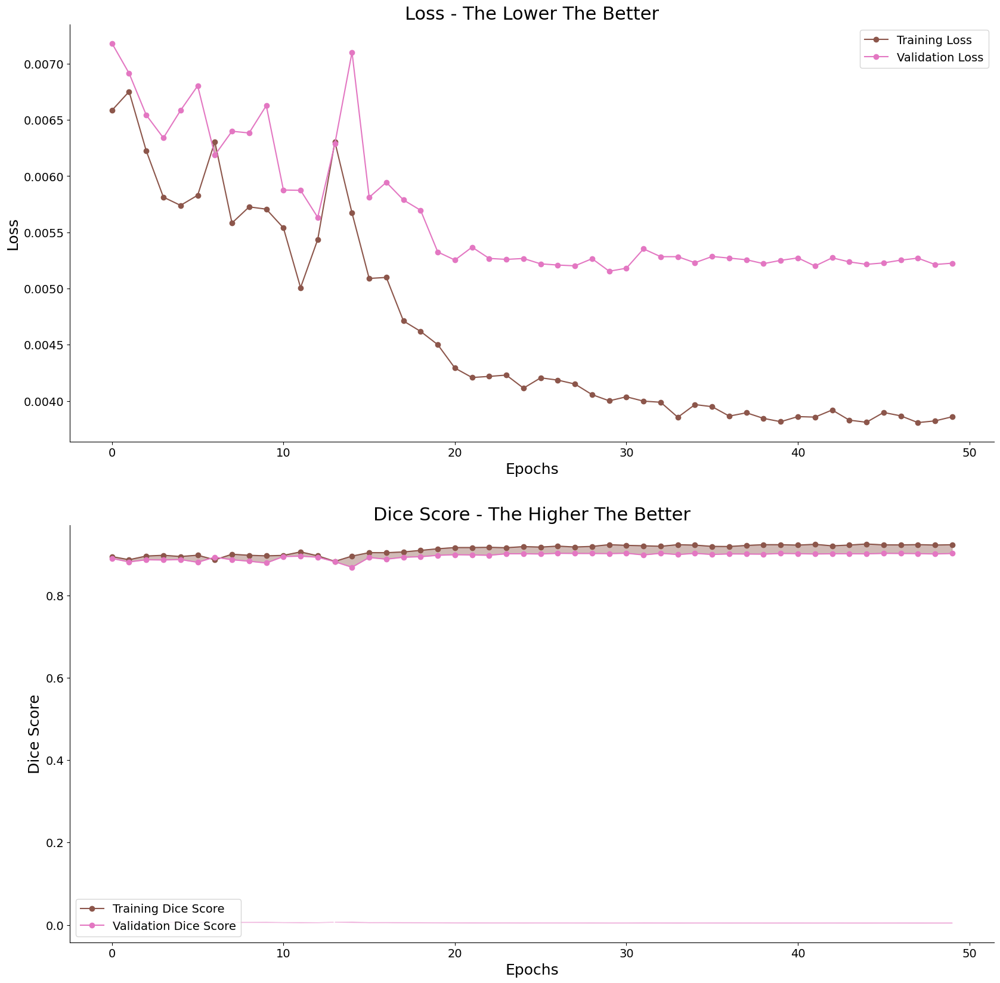

In [ ]:



plot_training_curves(unet_session_history, fig_size= (20, 20))

In [ ]:
def precision_(y_true, y_pred):
  intersection= (y_true * y_pred).sum()
  total_predicted_pixels= y_pred.sum()
  return (intersection/total_predicted_pixels).mean()

def recall_(y_true, y_pred):
  intersection= (y_true * y_pred).sum()
  total_true_pixels= y_true.sum()
  return (intersection/total_true_pixels).mean()

def dice_score(y_true, y_pred):
  eps= 1e-8
  intersection= (y_true * y_pred).sum()
  summation= (y_true + y_pred).sum()
  return ((2* intersection) / (summation + eps))

def jaccard_index(y_true, y_pred):
  eps= 1e-8
  intersection = (y_true * y_pred).sum()
  union= (y_true + y_pred).sum() - intersection
  return (intersection / (union+eps))


In [ ]:
def compute_metrics(
    model: nn.Module,
    sample_loader: torch.utils.data.DataLoader,
    device:torch.device
) -> np.ndarray:

  metrics= {
      'accuracy' : [],
      'precision': [],
      'recall' : [],
      'dice_score': [],
      'IoU': []
  }

  # Setting model into evaluation mode
  model.eval()

  with torch.inference_mode():

    for batch, (X, y) in enumerate(tqdm(sample_loader)):
      X= X.to(device)
      y= y.to(device)

      y_pred= model(X)

      predictions= torch.sigmoid(y_pred)
      predicted_class= (predictions > 0.3).float()

      # Computing Batch metrices for each mask
      for true_mask, pred_mask in zip(y, predicted_class):
        acc= ((true_mask == pred_mask ).sum() / torch.numel(true_mask)).cpu().item()
        prec= precision_(true_mask, pred_mask).cpu().item()
        rec= recall_(true_mask, pred_mask).cpu().item()
        dice= dice_score(true_mask, pred_mask).cpu().item()
        iou= jaccard_index(true_mask, pred_mask).cpu().item()

        metrics['accuracy'].append(acc)
        metrics['precision'].append(prec)
        metrics['recall'].append(rec)
        metrics['dice_score'].append(dice)
        metrics['IoU'].append(iou)

  return metrics













In [ ]:
unet_metrics= compute_metrics(sample_model, test_dl, DEVICE)

100%|██████████| 39/39 [00:13<00:00,  2.91it/s]


In [ ]:
unet_test_df= test_df.copy()

unet_test_df= pd.concat((unet_test_df, pd.DataFrame(unet_metrics)), axis= 1)

#Generate Diagnosis Labels
unet_test_df['model_diagnosis']= [int(mask.max()) for mask in unet_test_masks]

unet_test_df

,id,patient,image_path,mask_path,diagnosis,accuracy,precision,recall,dice_score,IoU,model_diagnosis
0,22,TCGA_DU_A5TS_19970726,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,1,0.997887,0.793878,0.987310,0.880090,0.785859,1
1,11,TCGA_DU_8165_19970205,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,0,1.000000,NaN,NaN,0.000000,0.000000,0
2,58,TCGA_HT_7881_19981015,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,0,1.000000,NaN,NaN,0.000000,0.000000,0
3,19,TCGA_DU_5853_19950823,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,0,1.000000,NaN,NaN,0.000000,0.000000,0
4,1,TCGA_DU_7298_19910324,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,0,1.000000,NaN,NaN,0.000000,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...
762,29,TCGA_DU_6399_19830416,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,1,0.998206,0.856444,0.996205,0.921053,0.853659,1
763,4,TCGA_DU_7294_19890104,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,0,1.000000,NaN,NaN,0.000000,0.000000,0
764,11,TCGA_HT_8105_19980826,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_H...,0,1.000000,NaN,NaN,0.000000,0.000000,0
765,22,TCGA_DU_7014_19860618,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,/content/lgg-mri-segmentation/kaggle_3m/TCGA_D...,1,0.997369,0.654167,0.762136,0.704036,0.543253,1


In [ ]:
def generate_performance_scores(y_true, y_pred, log= True):
  model_accuracy= accuracy_score(y_true, y_pred)
  model_precision, model_recall, model_f1, _= (precision_recall_fscore_support(y_true, y_pred, average= 'weighted'))

  model_matthews_corrcoeff= matthews_corrcoef(y_true, y_pred)

  if log:
    print("===============================================")
    print(f'accuracy_score:\t\t{model_accuracy:.4f}\n')
    print("===============================================")
    print(f'precision_score:\t{model_precision:.4f}\n')
    print("===============================================")
    print(f'recall_score:\t\t{model_recall:.4f}\n')
    print("===============================================")
    print(f'f1_score:\t\t{model_f1:.4f}\n')
    print("===============================================")
    print(f'mathhews_corrcoef:\t{model_matthews_corrcoeff:.4f}\n')
    print("===============================================")

  performance_metrics= {
      'accuracy_score': model_accuracy,
      'precision_score': model_precision,
      'recall_score': model_recall,
      'f1_score':model_f1,
      'matthews_corrcoef':model_matthews_corrcoeff
  }
  return performance_metrics





In [ ]:
test_labels= unet_test_df['diagnosis'].to_numpy()

unet_predictions= unet_test_df['model_diagnosis'].to_numpy()

In [ ]:
generate_performance_scores(test_labels, unet_predictions, log= True )

accuracy_score:		0.9687

precision_score:	0.9689

recall_score:		0.9687

f1_score:		0.9688

mathhews_corrcoef:	0.9315



{'accuracy_score': 0.9687092568448501,
 'precision_score': 0.9688723263000432,
 'recall_score': 0.9687092568448501,
 'f1_score': 0.9687621892444046,
 'matthews_corrcoef': 0.9314735918474801}